# Step 6: 2D Nonlinear convection

Now we move towards solving 2D convection which is represented by the pair of coupled PDE's seen below:

$$ \frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} + v\frac{\partial u}{\partial y} = 0 $$

$$ \frac{\partial v}{\partial t} + u \frac{\partial v}{\partial x} + v\frac{\partial v}{\partial y} = 0 $$

## Discretization

We'll discretize the two equations above pretty much in the exact same way we have been discretizing all equations previously yielding:

$$
 \frac{ u^{n+1}_{i,j} - u^n_{i,j}} {\Delta t} + u^{n}_{i,j} \frac{u^{n}_{i,j} - u^n_{i-1,j}}{\Delta x} + v^{n}_{i,j} \frac{u^{n}_{i,j} - u^n_{i,j-1}}{\Delta y} = 0
$$

$$
 \frac{ v^{n+1}_{i,j} - v^n_{i,j}} {\Delta t} + u^{n}_{i,j} \frac{v^{n}_{i,j} - v^n_{i-1,j}}{\Delta x} + v^{n}_{i,j} \frac{v^{n}_{i,j} - ^n_{i,j-1}}{\Delta y} = 0
$$

As always, we solve for our only unknown $u^{n+1}_{i,j}$ and iterate through the equation that follows:

This time we have two equations to solve for and therefore have two unknowns, $u^{n+1}_{i,j}$ and $v^{n+1}_{i,j}$. Note that the equations below are also coupled:

$$ u^{n+1}_{i,j} = u^n_{i,j} - u^n_{i,j} \frac{\Delta t}{\Delta x} (u^n_{i,j} - u^n_{i-1,j})  - v^n_{i,j} \frac{\Delta t}{\Delta y} (u^n_{i,j} - u^n_{i,j-1}) 
$$

$$ v^{n+1}_{i,j} = v^n_{i,j} - u^n_{i,j} \frac{\Delta t}{\Delta x} (v^n_{i,j} - v^n_{i-1,j})  - v^n_{i,j} \frac{\Delta t}{\Delta y} (v^n_{i,j} - v^n_{i,j-1}) 
$$

## Initial and Boundary Conditions

We will solve the equation with the same initial conditions as 1D convection but applied in both x and y directions:

$$ u,v = \begin{cases}
\begin{matrix}
2 & \text{for } x,y \in (0.5,1) \times (0.5,1) \cr
1 & \text{everywhere else}
\end{matrix}\end{cases}
$$

And boundary conditions:

$$ u = 1, v =1 \ \text{for}  \begin{cases}
\begin{matrix}
 x = 0,2 \cr
 y = 0,2 
\end{matrix}
\end{cases}
$$

The boundary conditions set u and v equal to 1 along boundaries of the grid:

## Libraries and Variable declarations

### Lib import

In [1]:
# Adding inline command to make plots appear under comments
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

### Variable Declarations

In [2]:
grid_length_x = 2
grid_length_y = 2
grid_points_x = 101
grid_points_y = 101
nt = 80
c = 1
dx = grid_length_x / (grid_points_x - 1) 
dy = grid_length_y / (grid_points_y - 1) 
sigma = .2 
dt = sigma*dx

x = np.linspace(0, grid_length_x, grid_points_x)
y = np.linspace(0, grid_length_y, grid_points_y)

u = np.ones((grid_points_x, grid_points_y))
v = np.ones((grid_points_x, grid_points_y))

un = np.ones((grid_points_x, grid_points_y))
vn = np.ones((grid_points_x, grid_points_y))

#Initiallizing the array containing the shape of our initial conditions
u[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2 
v[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2

### Plotting initial conditions

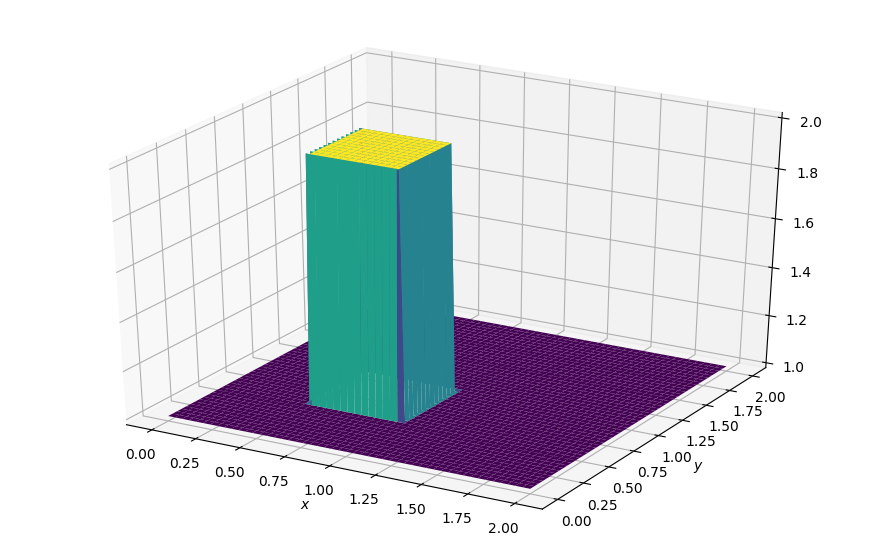

In [3]:
fig = plt.figure(figsize=(11,7), dpi= 100)
ax = fig.gca(projection='3d')
X,Y = np.meshgrid(x,y)

surf = ax.plot_surface(X,Y, u[:], cmap=cm.viridis, rstride=2, cstride=2)
ax.set_xlabel('$x$')
ax.set_ylabel('$y$');

## Solving in 2D

In [4]:
for n in range(nt + 1): ##loop across number of time steps
    un = u.copy()
    vn = u.copy()
    
    u[1:, 1:] = (un[1:, 1:] -
                 (un[1:,1:] * c * dt / dx * (un[1:, 1:] - un[1:, :-1])) -
                  vn[1:,1:] * c * dt / dy * (un[1:, 1:] - un[:-1, 1:]))
    
    v[1:, 1:] = (vn[1:, 1:] -
                 (un[1:,1:] * c * dt / dx * (vn[1:, 1:] - vn[1:, :-1])) -
                  vn[1:,1:] * c * dt / dy * (vn[1:, 1:] - vn[:-1, 1:]))

    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[:, 0] = 1
    v[:, -1] = 1

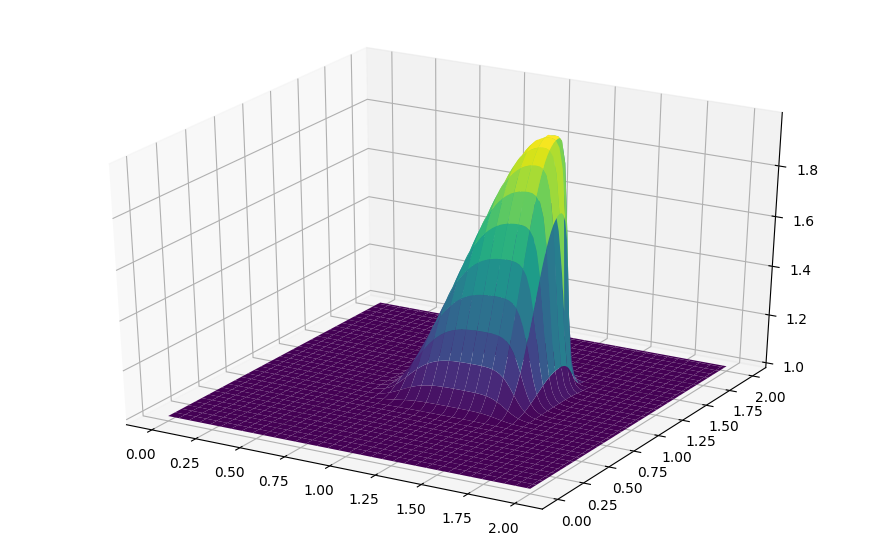

In [5]:
fig = plt.figure(figsize=(11,7), dpi=100)
ax  = fig.gca(projection='3d')
surf2 = ax.plot_surface(X,Y, u[:],cmap=cm.viridis)

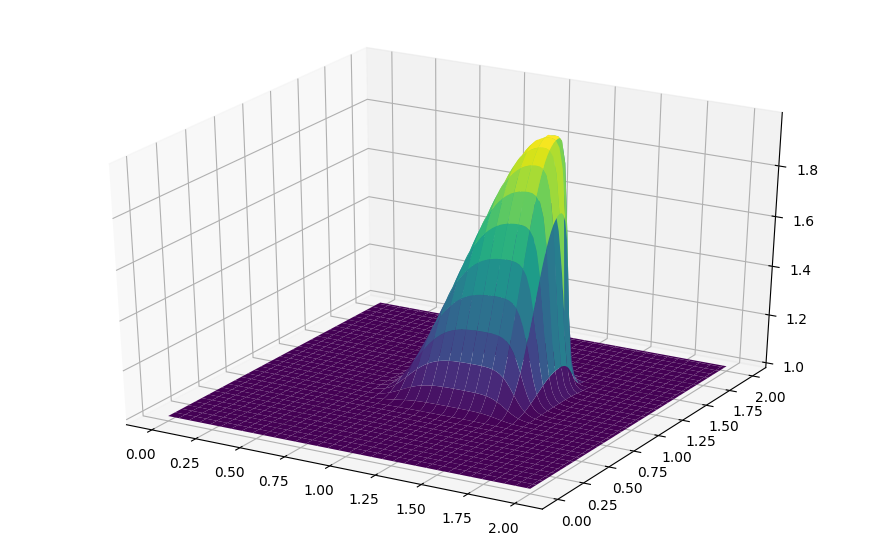

In [6]:
fig = plt.figure(figsize=(11,7), dpi=100)
ax  = fig.gca(projection='3d')
surf2 = ax.plot_surface(X,Y, v[:],cmap=cm.viridis)

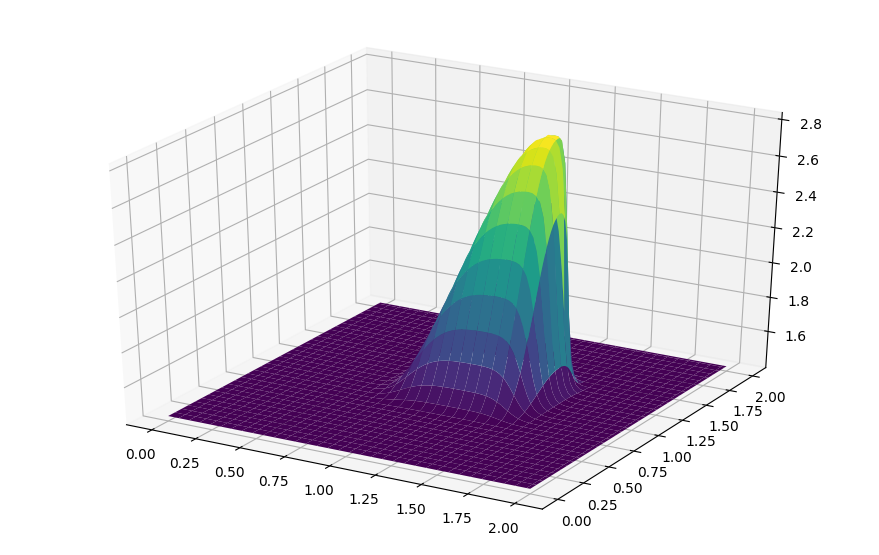

In [7]:
fig = plt.figure(figsize=(11,7), dpi=100)
ax  = fig.gca(projection='3d')
surf2 = ax.plot_surface(X,Y, np.sqrt(u**2 + v**2),cmap=cm.viridis)

### Results

As we can see, the same behavior from the 1D sim is also occurring here. It would also be very cool to see this in an animation, so as always, we are returning to the arduous task of building an animation of this sim.

But wait!! Before we can move towards doing that, let's rewrite the code above in a more vectorized form to speed it up and use it in our animation section.

## Animating the simulation

/home/angel/.local/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Requested projection is different from current axis projection, creating new axis with requested projection.
  


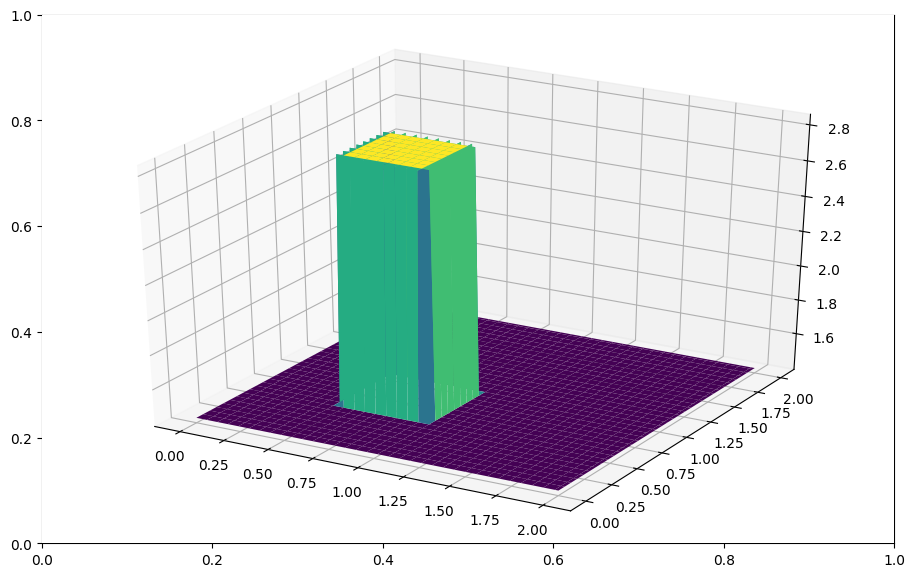

In [8]:
#Imports for animation and display within a jupyter notebook
from matplotlib import animation, rc 
from IPython.display import HTML

#Resetting the U wave back to initial conditions
u = np.ones((grid_points_x, grid_points_y))
v = np.ones((grid_points_x, grid_points_y))
u[int(.5 / dy):int(1 / dy + 1), int(.5 / dx):int(1 / dx + 1)] = 2
v[int(.5 / dy):int(1 / dy + 1),int(.5 / dx):int(1 / dx + 1)] = 2
#Generating the figure that will contain the animation
fig, ax = plt.subplots()
fig.set_dpi(100)
fig.set_size_inches(11,7)
ax = fig.gca(projection='3d')

surf = ax.plot_surface(X, Y, np.sqrt(u**2 + v**2) , cmap=cm.viridis)



In [9]:
#Initialization function for funcanimation
def init():
    ax.clear()
    surf = ax.plot_surface(X, Y, np.sqrt(u**2 + v**2)  , cmap=cm.viridis)
    return surf

In [10]:
#Main animation function, each frame represents a time step in our calculation
def animate(j):
    un = u.copy()
    vn = u.copy()
    
    u[1:, 1:] = (un[1:, 1:] -
                 (un[1:,1:] * c * dt / dx * (un[1:, 1:] - un[1:, :-1])) -
                  vn[1:,1:] * c * dt / dy * (un[1:, 1:] - un[:-1, 1:]))
    
    v[1:, 1:] = (vn[1:, 1:] -
                 (un[1:,1:] * c * dt / dx * (vn[1:, 1:] - vn[1:, :-1])) -
                  vn[1:,1:] * c * dt / dy * (vn[1:, 1:] - vn[:-1, 1:]))

    u[0, :] = 1
    u[-1, :] = 1
    u[:, 0] = 1
    u[:, -1] = 1
    
    v[0, :] = 1
    v[-1, :] = 1
    v[:, 0] = 1
    v[:, -1] = 1
    ax.clear()
    surf = ax.plot_surface(X, Y, np.sqrt(u**2 + v**2)  , cmap=cm.viridis)
    return surf

In [11]:
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=nt, interval=20)
HTML(anim.to_jshtml())

## Conclusion

Also pretty cool! Next we will solve diffusion in 2D.